CVPRO Competition v1.0.0.<br>
Code Developed by Augustin Rajkumar, Suresh Balaji, E.V.V Thrilok kumar, and Meritus R & D Team - November 09, 2023.<br>
Copyright © 2023 Meritus R & D Team. All rights reserved.<br>
This program is the intellectual property of Meritus AI, and may not be distributed 
or reproduced without explicit authorization from the copyright holder.<br>
This notebook helps in training your model based on your data collected

Import packages

In [1]:
from Utils.createdataset import CreateDataset
from Utils.encoder import Labeling
from Utils.train import TrainingModel

Parameters of Batch-size, Epochs and Learning-rate

In [2]:
batch_size = 32
epochs = 5
learning_rate = 0.0001

Create a Dataset

In [3]:
preprocess = CreateDataset()
root_folder, log_file_path = preprocess.main_folder()
folder_list = preprocess.path_folders()

Training Progress is Started....
Dataset_Folder : d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data/Dataset_CVPRO\Self_Driving
List_Folder : d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data/Dataset_CVPRO\Self_Driving\20231108_172012
Inside_Folder_Path : d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data/Dataset_CVPRO\Self_Driving\20231108_172012\1


To save the dataframe of each folder

In [4]:
save_df = preprocess.data_frame()
csv_path = preprocess.list_to_dataframe(save_df)

Self_Driving
Folder_Path:d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data/Dataset_CVPRO\Self_Driving\20231108_172012\1\Files/Frame.csv
The CSV File not found. Please, Continue.... 
dataframe path: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\cvpro.csv


To show the random_images from the datasets

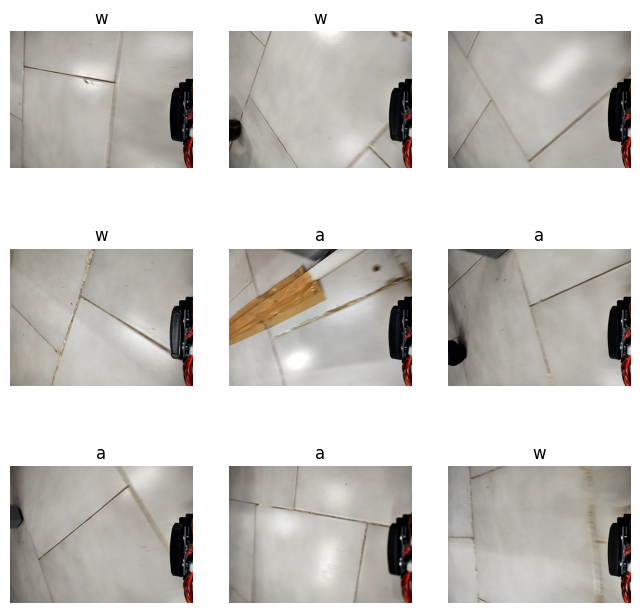

In [5]:
preprocess.random_images(csv_path)

Encoding the labels

In [6]:
encode_label = Labeling(root_folder, csv_path)
data, encoding_label, unique_values, decoding_label = encode_label.encoder_label()

To show the plot of labels with their counts

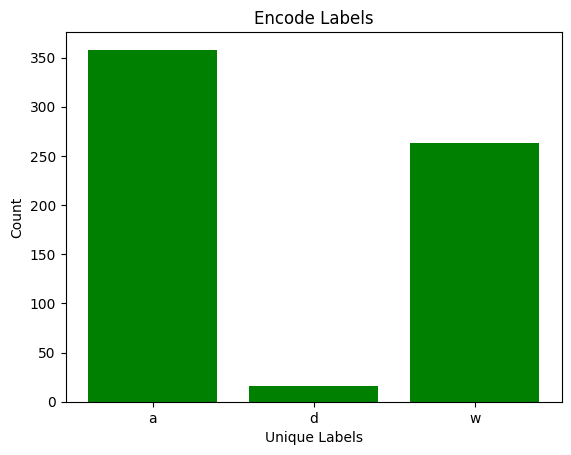

In [7]:
encode_label.show_encode_plot()

No.of Classes for the training neural network

In [8]:
num_classes = encode_label.num_label()

Number of classes:  3
unique_values ['a' 'd' 'w']
value_counts [358  16 263]


Getting Images and Controls values

In [9]:
images_path, controls = encode_label.load_data()

100%|██████████| 637/637 [00:00<00:00, 33503.94it/s]


Create an instance of TrainingModel

In [10]:
training_model = TrainingModel(root_folder, images_path, controls, num_classes)

Save Folder is created successfully!


Split the data

In [11]:
x_train, x_val, x_test, y_train, y_val, y_test = training_model.split_data()

Total Training Images is 509 and Total Testing Images is 128 and Total Testing Images is 102


Create the custom data generator

In [12]:
train_generator = training_model.CustomDataGenerator(x_train, y_train, batch_size)
val_generator = training_model.CustomDataGenerator(x_val, y_val, batch_size)
test_generator = training_model.CustomDataGenerator(x_test, y_test, batch_size)

Create the model

In [13]:
model = training_model.create_model(learning_rate)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 31, 98, 32)        2432      
                                                                 
 conv2d_1 (Conv2D)           (None, 14, 47, 36)        28836     
                                                                 
 conv2d_2 (Conv2D)           (None, 5, 22, 48)         43248     
                                                                 
 conv2d_3 (Conv2D)           (None, 3, 20, 64)         27712     
                                                                 
 conv2d_4 (Conv2D)           (None, 1, 18, 64)         36928     
                                                                 
 flatten (Flatten)           (None, 1152)              0         
                                                                 
 dense (Dense)               (None, 1164)              1

Train the model

In [14]:
history, best_checkpoint, last_checkpoint = training_model.train(model, epochs, train_generator, val_generator)

Epoch 1/5
16/16 [==============================] - ETA: 0s - loss: 0.9526 - Accuracy: 0.5206

INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_1\assets


INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_1\assets


16/16 [==============================] - 14s 751ms/step - loss: 0.9526 - Accuracy: 0.5206 - val_loss: 0.8411 - val_Accuracy: 0.5490
Epoch 2/5
16/16 [==============================] - ETA: 0s - loss: 0.7893 - Accuracy: 0.5599

INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_2\assets


INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_2\assets


16/16 [==============================] - 6s 358ms/step - loss: 0.7893 - Accuracy: 0.5599 - val_loss: 0.8007 - val_Accuracy: 0.5490
Epoch 3/5
16/16 [==============================] - ETA: 0s - loss: 0.7850 - Accuracy: 0.5599

INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_3\assets


INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_3\assets


16/16 [==============================] - 6s 373ms/step - loss: 0.7850 - Accuracy: 0.5599 - val_loss: 0.7998 - val_Accuracy: 0.5490
Epoch 4/5
16/16 [==============================] - ETA: 0s - loss: 0.7822 - Accuracy: 0.5599

INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_4\assets


INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_4\assets


16/16 [==============================] - 6s 373ms/step - loss: 0.7822 - Accuracy: 0.5599 - val_loss: 0.7989 - val_Accuracy: 0.5490
Epoch 5/5
16/16 [==============================] - ETA: 0s - loss: 0.7814 - Accuracy: 0.5599

INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_5\assets


INFO:tensorflow:Assets written to: d:\WorkingFiles\CVPro-Competition-Kit-main\Training_Process\Training_Data\Save_Model\checkpoints\checkpoint_5\assets


16/16 [==============================] - 6s 374ms/step - loss: 0.7814 - Accuracy: 0.5599 - val_loss: 0.7976 - val_Accuracy: 0.5490


Evaluate the model

In [15]:
training_model.evaluate(model, test_generator)

4/4 - 2s - loss: 0.7975 - Accuracy: 0.5703 - 2s/epoch - 553ms/step
Test Loss : 0.797458 and  Test Accuracy : 0.57


Predict with the model

In [16]:
true_labels, predict_classes = training_model.predict(model, test_generator)

4/4 [==============================] - 1s 150ms/step
Predictions:  [[0.547137   0.02777995 0.42508304]
 [0.5484359  0.02743306 0.42413098]
 [0.5416142  0.03138063 0.4270052 ]
 [0.5409925  0.03309808 0.42590946]
 [0.5477772  0.02729751 0.4249253 ]
 [0.5461626  0.02764624 0.42619118]
 [0.54242295 0.03242105 0.42515597]
 [0.5496394  0.02680601 0.42355454]
 [0.5407625  0.03348168 0.42575592]
 [0.54003674 0.03564484 0.42431834]
 [0.54635996 0.03104567 0.42259437]
 [0.54463196 0.0299776  0.4253904 ]
 [0.5358753  0.0370382  0.42708647]
 [0.540808   0.033671   0.42552105]
 [0.5440869  0.03032985 0.42558324]
 [0.5415302  0.03189493 0.42657495]
 [0.5332814  0.03908754 0.4276311 ]
 [0.5427463  0.03134044 0.4259133 ]
 [0.54308563 0.03245572 0.4244587 ]
 [0.54278076 0.03158258 0.42563662]
 [0.5452481  0.03183689 0.42291504]
 [0.5486626  0.02781207 0.4235254 ]
 [0.55374324 0.0244419  0.42181486]
 [0.54535484 0.03175418 0.422891  ]
 [0.5413436  0.03250886 0.42614746]
 [0.53992635 0.03426679 0.4258068

Calculate metrics

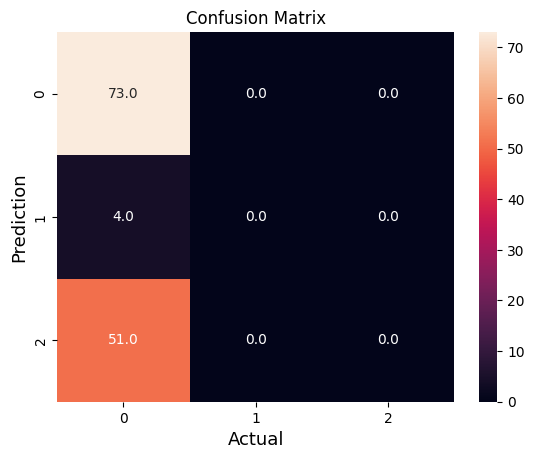

Accuracy  : 0.5703125
Precision : [0.5703125 0.        0.       ]
Recall    : [1. 0. 0.]
F1-score  : [0.72636816 0.         0.        ]


d:\ProgramFiles\Conda\cvpro\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [17]:
training_model.conf_matrix(true_labels, predict_classes)
ACCURACY = training_model.train_metrics(true_labels, predict_classes)

Convert to TFLite

In [18]:
training_model.convert_to_tflite(ACCURACY, best_checkpoint, last_checkpoint)

TFLite Model Files saved


(b'\x1c\x00\x00\x00TFL3\x14\x00 \x00\x1c\x00\x18\x00\x14\x00\x10\x00\x0c\x00\x00\x00\x08\x00\x04\x00\x14\x00\x00\x00\x1c\x00\x00\x00\x80\x00\x00\x00\xd8\x00\x00\x00X\xdfa\x00h\xdfa\x00@\xf1a\x00\x03\x00\x00\x00\x01\x00\x00\x00\x04\x00\x00\x00\xd6\x1e\x9e\xff\x0c\x00\x00\x00\x1c\x00\x00\x008\x00\x00\x00\x0f\x00\x00\x00serving_default\x00\x01\x00\x00\x00\x04\x00\x00\x00\x9c\xff\xff\xff!\x00\x00\x00\x04\x00\x00\x00\x07\x00\x00\x00dense_4\x00\x01\x00\x00\x00\x04\x00\x00\x00n \x9e\xff\x04\x00\x00\x00\x07\x00\x00\x00input_1\x00\x02\x00\x00\x004\x00\x00\x00\x04\x00\x00\x00\xdc\xff\xff\xff$\x00\x00\x00\x04\x00\x00\x00\x13\x00\x00\x00CONVERSION_METADATA\x00\x08\x00\x0c\x00\x08\x00\x04\x00\x08\x00\x00\x00#\x00\x00\x00\x04\x00\x00\x00\x13\x00\x00\x00min_runtime_version\x00%\x00\x00\x00|\xdea\x00t\xdea\x004\xcca\x00\x18\xcca\x00\xe0\xcba\x00\x08\xcba\x00h\xc9a\x00\xd8\xc8a\x00\xc8\xc7a\x00\xb8\xc6a\x00\xe8\xc5a\x00H\xc5a\x000\xc5a\x00 \xed\x0f\x00P\xd2\x08\x00 \x84\x08\x00@|\x08\x00\xb8{\x08\x00(V

Save labels

In [19]:
training_model.save_labels(decoding_label)

Labels Files saved
Training Progress is Completed Successfully
